## Ensure that the X-Y pairs up to this point make sense.

Goals: Audit of the spectra stored in the XY pair files. This is more of a 'scratch' notebook.

In [1]:
import numpy as np
target_elements_groups=[('Ti','O'),('V','O'),('Cr','O'),('Mn','O'),
                        ('Fe','O'),('Co','O'),('Ni','O'),('Cu','O')]
target_metals = set(['Co','Ni','Fe','Cr','V','Mn','Cu','Ti'])
target_elements_sets =[set(pair) for pair in target_elements_groups]

x_domains = {  ('Co','O'):  np.linspace(7713.5, 7765.83,100),
               ('Fe','O'): np.linspace(7115.0, 7167.764,100),
               ('V','O'):  np.linspace(5468.0, 5520.631,100),
               ('Cu','O'): np.linspace( 8987.5, 9039.712,100),
               ('Ni','O'): np.linspace( 8336.5 ,8388.723,100),
               ('Cr','O'): np.linspace(5993.1, 6045.686,100),
               ('Mn','O'): np.linspace(6541.7, 6594.417,100),
               ('Ti','O'): np.linspace(4969.0, 5021.024,100)}

import os
import sys
sys.path.append('/n/home11/storrisi/TRIX/X-Ray-Spectroscopy')

!pip install --upgrade matplotlib --user

  Using cached https://files.pythonhosted.org/packages/7e/07/4b361d6d0f4e08942575f83a11d33f36897e1aae4279046606dd1808778a/matplotlib-3.1.3-cp36-cp36m-manylinux1_x86_64.whl


# NOTE: CURRENTLY POINTED TOWARDS THE BACKUP WITHOUT NEW METADATA

In [2]:
from pymatgen.ext.matproj import MPRester
from pymatgen.core import Structure
from trixs.spectra.core import XAS_Spectrum, XAS_Collation
from trixs.spectra.util import NumpyEncoder
import matplotlib
from matplotlib.collections import LineCollection
from matplotlib.patches import Rectangle

from tqdm import tqdm, tqdm_notebook
from pprint import pprint
import json
import os
import numpy as np
import matplotlib.pyplot as plt

from pandas import DataFrame
storage_directory = '/Users/steven/Documents/Research/Projects/TRIX/data/final_XY'

storage_directory = '/n/home11/storrisi/TRIX/data/final_XY/feff_november_backup'
storage_directory = '/n/home11/storrisi/TRIX/data/final_XY'


# Load in Data

In [4]:
data_by_pair = {pair:[] for pair in target_elements_groups}
for pair in target_elements_groups:
    file_target = storage_directory+'/{}_{}_XY_feff_november.json'.format(pair[0],pair[1])
    #file_target = storage_directory+'/{}_{}_XY_MP_only_november.json'.format(pair[0],pair[1])

    try:
        with open(file_target,'r') as f:
            data_by_pair[pair] = [json.loads(line) for line in f.readlines()]
            
    except:
        print("WARNING!")
        pass




## Test the outlier process

In [5]:

for pair in target_elements_groups:
    ineligible = 0
    outliered = 0
    unfeaturized = 0
    counted =0
    new_data = []
    for data in tqdm_notebook(data_by_pair[pair],desc=pair[0]):
        if not(data.get('bader') or data['coordination'] in [4,5,6]):
            ineligible +=1 
            continue
        
        if not prune_outliers(data['mu']):
            outliered +=1
            continue
        
        if not one_shot_poly_error_fit(x_domains[pair],data['mu']):
            unfeaturized += 1
            continue
        counted +=1
        new_data.append(data)
        
    data_by_pair[pair] = new_data
    print(f" {pair}:Remaining={counted}, Ineligible={ineligible}, Outliered={outliered}, Unfeaturized= {unfeaturized}, ")
    
            
    


 ('Ti', 'O'):Remaining=4793, Ineligible=57, Outliered=26, Unfeaturized= 54, 



 ('V', 'O'):Remaining=6929, Ineligible=30, Outliered=12, Unfeaturized= 149, 



 ('Cr', 'O'):Remaining=2395, Ineligible=8, Outliered=18, Unfeaturized= 121, 



 ('Mn', 'O'):Remaining=7917, Ineligible=42, Outliered=504, Unfeaturized= 41, 



 ('Fe', 'O'):Remaining=6744, Ineligible=25, Outliered=523, Unfeaturized= 70, 



 ('Co', 'O'):Remaining=3453, Ineligible=7, Outliered=66, Unfeaturized= 7, 



 ('Ni', 'O'):Remaining=3396, Ineligible=11, Outliered=12, Unfeaturized= 1, 



 ('Cu', 'O'):Remaining=3444, Ineligible=21, Outliered=31, Unfeaturized= 0, 


In [6]:
prune_numbers = lambda x: str([c for c in x if c.isalpha()]).strip('[').strip(']').replace(',','').replace(' ','').replace("'",'')
prune_numbers_from_comp = lambda x: [prune_numbers(x) for x in x.split(' ')]
#print(prune_numbers_from_comp('Ag2 Zn12'))

In [7]:
def metadata_to_composition(data):
    
    metadata = data.get('metadata')
    if metadata is None:
        print("missing metadata from data point")
        return None
    
    string = metadata.get('id')   
    composition = metadata.get('composition')
    if string is None and metadata['origin']!='feff':
        print('Found no ID: Metadata is',metadata)
        return None
    if string is None:
        #print("Missing for:",metadata)
        return composition
    if 'mp' in string or 'mvc' in string:
        try:
            structure = mpr.get_structure_by_material_id(string)
            return str(structure.composition)
        except:
            try:
                new_id = mpr.get_materials_id_from_task_id(string)
                return str(mpr.get_structure_by_material_id(new_id).composition)
            except:
                print('Rester failed on:',string,new_id)
                return None
    elif 'feff' in string:
        return metadata.get('composition',None)
    

# Gauge Composition

In [ ]:
from pymatgen.ext.matproj import MPRester
from tqdm import tqdm, tqdm_notebook
import json

from trixs.spectra.core import XAS_Collation
from pymatgen.core.structure import Structure
from pymatgen.analysis.structure_matcher import StructureMatcher, ElementComparator

mpr = MPRester('v2anpbHsAOr4tmXQ')
compositions_by_pair = {pair: [] for pair in target_elements_groups}

    

anions = set(['N','F','P','S','Se','F','Cl','Br','I','C','H'])
anions_count = {anion: 0 for anion in anions}
anions_by_pair = {pair:{anion:0 for anion in anions} for pair in target_elements_groups}

for pair in target_elements_groups:
    for data in tqdm_notebook(data_by_pair[pair],desc=pair[0]):
        if data.get('bader'):
            cur_comp = prune_numbers_from_comp(metadata_to_composition(data))
            
            compositions_by_pair[pair].append(cur_comp)
            
            for elt in cur_comp:
                if elt in anions:
                    anions_by_pair[pair][elt]+=1

In [11]:
anions = set(['N','F','P','S','Se','F','Cl','Br','I','C','H'])

for pair in target_elements_groups:
    anions_by_pair[pair]['O*']=0
    
    for comp in compositions_by_pair[pair]:
        if len(set(comp).intersection(anions))==0:
            anions_by_pair[pair]['O*']+=1
    

In [15]:
anion_list = ['H','C','N','F','P','S','Cl','Se','Br','I','O*','Total']
header_str = 'Elt,'
for elt in anion_list:
    header_str += elt+','

header_str+='\n'

with open('../RF/gen_figures/anion_table.csv','w') as f:
    
    f.write(header_str)
    print(header_str)
    for pair in target_elements_groups:
        
        cur_str = pair[0]+','
        for anion in anion_list[:-1]:
            cur_str += str(anions_by_pair[pair][anion])+','
        cur_str += str(len([data for data in data_by_pair[pair] if data.get('bader')]))
        cur_str+='\n'
        print(cur_str)
        f.write(cur_str)
    


Elt,H,C,N,F,P,S,Cl,Se,Br,I,O*,Total,

Ti,57,11,52,57,440,40,13,2,8,1,2578,3201

V,264,137,40,712,899,75,22,19,2,8,1988,3863

Cr,99,59,39,55,446,53,23,0,3,4,1188,1809

Mn,274,283,31,468,1082,106,25,23,14,11,2237,4031

Fe,219,259,47,476,928,89,37,65,4,7,2175,3908

Co,102,167,27,215,441,64,32,29,8,9,1170,2075

Ni,110,124,46,99,666,63,19,22,4,9,1289,2224

Cu,205,145,70,86,484,73,71,65,15,10,1227,2167



# Generating Figures

## Re-Done Line Collection / Subpot Form

('Ti', 'O') 4793
('V', 'O') 6929
('Cr', 'O') 2395
('Mn', 'O') 7917
('Fe', 'O') 6744
('Co', 'O') 3453
('Ni', 'O') 3396
('Cu', 'O') 3444


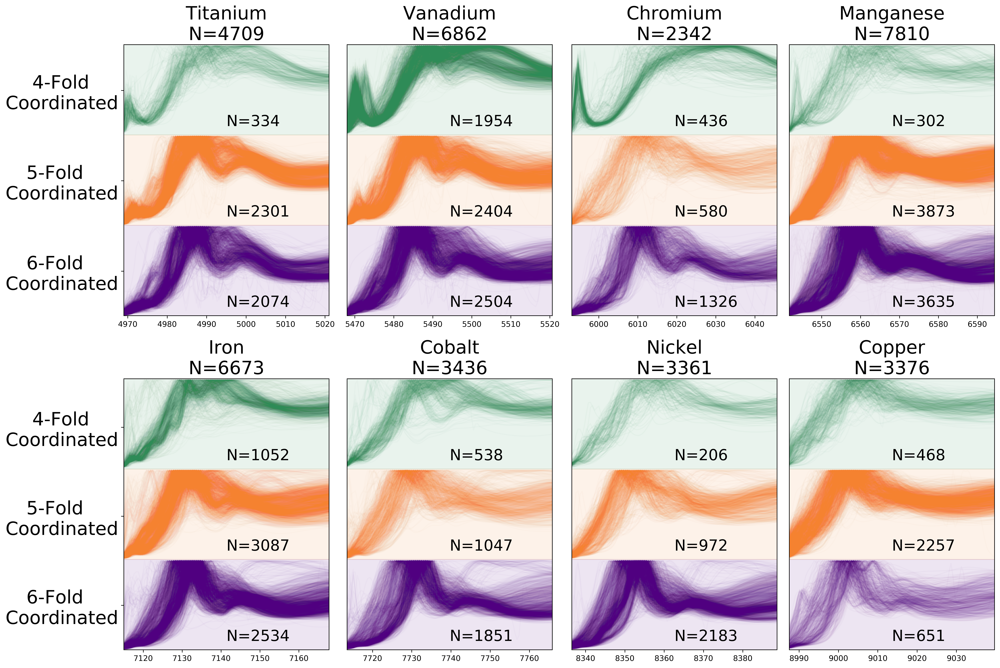

In [11]:
#%%script false --no-raise-error

from math import sqrt



coord_alph_by_pair = {
                   ('Co','O'): {4:.1,5:.1,6:.1},
                   ('Fe','O'): {4:.1,5:.1,6:.1},
                   ('V','O'):  {4:.1,5:.1,6:.1},
                   ('Cu','O'): {4:.1,5:.1,6:.1},
                   ('Ni','O'): {4:.1,5:.1,6:.1},
                   ('Cr','O'): {4:.1,5:.1,6:.1},
                   ('Mn','O'): {4:.1,5:.1,6:.1},
                   ('Ti','O'): {4:.1,5:.1,6:.1}}

pair_to_label={'Co':'Cobalt',
              'Fe':'Iron',
              'V':'Vanadium',
              'Cu':'Copper',
              'Ni':'Nickel',
              'Cr':'Chromium',
              'Mn':'Manganese',
              'Ti':'Titanium'}

lc_by_pair = {pair:[] for pair in target_elements_groups}


    
coord_fig = plt.figure(figsize=(18,12),constrained_layout = True,dpi=450)
gs = coord_fig.add_gridspec(2,4)

ax1 = coord_fig.add_subplot(gs[0,0])
ax2 = coord_fig.add_subplot(gs[0,1])
ax3 = coord_fig.add_subplot(gs[0,2])
ax4 = coord_fig.add_subplot(gs[0,3])
ax5 = coord_fig.add_subplot(gs[1,0])
ax6 = coord_fig.add_subplot(gs[1,1])
ax7 = coord_fig.add_subplot(gs[1,2])
ax8 = coord_fig.add_subplot(gs[1,3])

all_axes = [ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8]

font = {'family': 'sans-serif',
        'color':  'black',
        'weight': 'normal',
        'size': 16,
        }

vert_offset = .015
for i, pairdat in enumerate(data_by_pair.items()):
    pair = pairdat[0]
    data = pairdat[1]
    ax = all_axes[i]
    
    relevant_coordination = [6,5,4]
    coord_count = {coord:0 for coord in relevant_coordination}
    
    filtered_by_coords =[dat for dat in data if dat['coordination'] in relevant_coordination]
    print(pair,len(data))

    cur_spectra =[XAS_Spectrum(dat['E'],dat['mu']) for dat in filtered_by_coords]
    for i, dat in enumerate(filtered_by_coords):
        cur_spectra[i].coord = dat['coordination'] 
        
    
    ##max_4 = np.max([np.max(spec.y) for spec in cur_spectra if spec.coord==4])
    #max_5 = np.max([np.max(spec.y) for spec in cur_spectra if spec.coord==5])
    #max_6 = np.max([np.max(spec.y) for spec in cur_spectra if spec.coord==6])
    
    #max_by_coord = {4:max_4,5:max_5,6:max_6}
    #print(max_by_coord)
    
    for spec in cur_spectra:
        spec.normalize('max')
        
    for dat in filtered_by_coords:
        coord_count[dat['coordination']] += 1
        
    color_mapper={4:"seagreen",
                   5:np.array((245,130,48))/255,
                   6:np.array((80,0,128))/255}
    
    min_x = np.min([np.min(spec.x) for spec in cur_spectra])
    max_x = np.max([np.max(spec.x) for spec in cur_spectra])
    
    np.random.shuffle(cur_spectra)
    coord_alph_by_freq = {4:1/np.log2(20*coord_count[4]),5:1/np.log2(20*coord_count[5]),6:1/np.log2(20*coord_count[6])}
    for coord in [6,5,4]:
        
        lines = [np.column_stack([spec.x,spec.y/np.max(spec.y)+abs(coord-6)*1.015]) for spec in cur_spectra
                if spec.coord == coord ]
        color_array = [color_mapper[coord]]*len(lines)
        alpha = coord_alph_by_pair[pair][coord]/np.sqrt(sqrt(coord_count[coord]))
        #alpha = coord_alph_by_freq[coord]
        lc = LineCollection(lines,colors=color_array,
                           alpha = alpha)
        ax.add_collection(lc)
        rect = Rectangle((min_x,abs(coord-6)*1.015),width=max_x,
                          height=1.015,color=color_mapper[coord],alpha=.1)
        ax.add_patch(rect)
        ax.text(min_x + .50*(max_x-min_x),abs(coord-6)*(1+vert_offset)+.1,
                'N={}'.format(coord_count[coord]),color='black',size=20)
                #fontdict=font

    ax.set_ylim(0,3+3*vert_offset)
    ax.set_xlim(min_x,max_x)
    ax.set_yticks([])
    #ax.set_title("{}\nN= {}".format(pair_to_label[pair[0]],len(filtered_by_coords)),color='Black',size=24)
    ax.set_title("{}\nN={}".format(pair_to_label[pair[0]],len(filtered_by_coords)),color='Black',size=24)


ax1.set_yticklabels(['6-Fold      \nCoordinated','5-Fold      \nCoordinated','4-Fold     \nCoordinated'],fontsize=24)
ax1.set_yticks([.5,1.5+.015,2.5+.03])
ax1.tick_params(axis='y', which='major', labelsize=24)

ax5.set_yticklabels(['6-Fold      \nCoordinated','5-Fold      \nCoordinated','4-Fold     \nCoordinated'],fontsize=24)
ax5.set_yticks([.5,1.5,2.5])
ax5.tick_params(axis='y', which='major', labelsize=24)

#plt.savefig("../RF/gen_figures/coord_spectra.pdf",format='pdf',dpi=300,bbox_inches='tight',transparent=True)
plt.savefig("../RF/gen_figures/coord_spectra.png",format='png',dpi=300,bbox_inches='tight')

plt.show()

0.008512100000000088 2.801722
('Ti', 'O') 3201
('V', 'O') 3863
('Cr', 'O') 1809
('Mn', 'O') 4031
('Fe', 'O') 3908
('Co', 'O') 2075
('Ni', 'O') 2224
('Cu', 'O') 2167


/n/home11/storrisi/.conda/envs/trix/lib/python3.6/site-packages/ipykernel_launcher.py:109: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


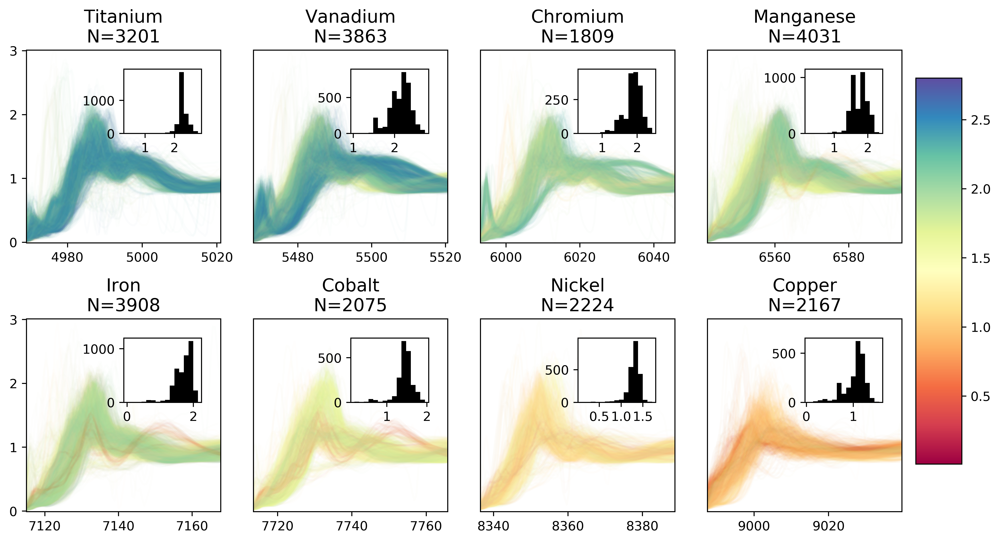

In [16]:
#%%script false --no-raise-error

from mpl_toolkits.axes_grid.inset_locator import inset_axes
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
import matplotlib.colors as colors
import matplotlib.cm as cm

coord_alph_by_pair = {
                   ('Co','O'): {4:.1,5:.1,6:.1},
                   ('Fe','O'): {4:.1,5:.1,6:.1},
                   ('V','O'):  {4:.1,5:.1,6:.1},
                   ('Cu','O'): {4:.1,5:.1,6:.1},
                   ('Ni','O'): {4:.1,5:.1,6:.1},
                   ('Cr','O'): {4:.1,5:.1,6:.1},
                   ('Mn','O'): {4:.1,5:.1,6:.1},
                   ('Ti','O'): {4:.1,5:.1,6:.1}}


lc_by_pair = {pair:[] for pair in target_elements_groups}

global_max_bader = -1000
global_min_bader = 1000

for i, pairdat in enumerate(data_by_pair.items()):
    data = pairdat[1]
    filtered_by_bader =[dat for dat in data if dat.get('bader')]
    
    baders = [dat['bader'] for dat in filtered_by_bader]
    global_max_bader = max(global_max_bader,np.max(baders))
    global_min_bader = min(global_min_bader,np.min(baders))
    
#bader_fig = plt.figure(figsize=(12,10),constrained_layout = True,dpi=450)
bader_fig = plt.figure(figsize=(10,6),constrained_layout = False,dpi=450)

gs = bader_fig.add_gridspec(2,4)

spec_map = plt.cm.get_cmap('Spectral')
print(global_min_bader,global_max_bader)
norm = colors.Normalize(vmin=global_min_bader, vmax=global_max_bader)

ax1 = bader_fig.add_subplot(gs[0,0])
ax2 = bader_fig.add_subplot(gs[0,1])
ax3 = bader_fig.add_subplot(gs[0,2])
ax4 = bader_fig.add_subplot(gs[0,3])
ax5 = bader_fig.add_subplot(gs[1,0])
ax6 = bader_fig.add_subplot(gs[1,1])
ax7 = bader_fig.add_subplot(gs[1,2])
ax8 = bader_fig.add_subplot(gs[1,3])

all_axes = [ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8]

for i, pairdat in enumerate(data_by_pair.items()):

    pair = pairdat[0]
    data = pairdat[1]
    ax = all_axes[i]
    baders = [dat['bader'] for dat in data if dat['bader']]
    filtered_by_bader =[dat for dat in data if dat.get('bader')]
    cur_spectra =[XAS_Spectrum(dat['E'],dat['mu']) for dat in filtered_by_bader]
    
    for i, dat in enumerate(filtered_by_bader):
        cur_spectra[i].bader = dat['bader'] 
    #for spec in cur_spectra:
    #    spec.normalize('max')
         
    np.random.shuffle(cur_spectra)
    print(pair,len(filtered_by_bader))
    
    min_x = np.min([np.min(spec.x) for spec in cur_spectra])
    max_x = np.max([np.max(spec.x) for spec in cur_spectra])
    
    min_bader = np.min(baders)
    max_bader = np.max(baders)

    
    lines = [np.column_stack([spec.x,spec.y]) for spec in cur_spectra]
    color_array = [spec_map(norm(spec.bader)) for spec in cur_spectra]

    lc = LineCollection(lines,colors=color_array,
                       alpha = 1/np.sqrt(len(lines)))
    ax.add_collection(lc)
    
    #ax.ylabel("$\mu (E)$")
    ax.set_ylim(-.01,3.01)
    ax.set_xlim(min_x,max_x)
    ax.set_yticks([])

    ins_ax = inset_axes(ax,
                        loc=1,
                        #bbox_to_anchor=(min_x+.75*(max_x-min_x), .25, 1,1),
                    width="40%", # width = 30(% of parent_bbox
                    height=0.7, # height=1.0
                       borderpad=1.5) # height : 1 inch
    #ins_ax = inset_axes(ax,width=1.,height=1.,bbox_to_anchor=(min_x+ (max_x-min_x)*.75,.5),
    #                   )

    plt.hist(baders,color='black',bins=15)
    ax.set_title("{}\nN={}".format(pair_to_label[pair[0]],len(filtered_by_bader)),color='black',
                size=14),
    if pair[0]=='Ti' or pair[0]=='Fe':
        ax.set_yticks([0,1,2,3])
    #ax.set_xticks([])
    
bader_fig.subplots_adjust(right=0.9)
#cbar_ax = bader_fig.add_axes([0.95, 0.15, 0.05, 0.7])
cbar_ax = bader_fig.add_axes([1.0, 0.15, 0.05, 0.7])

bader_fig.colorbar(cm.ScalarMappable(norm=norm, cmap=spec_map), cax=cbar_ax,shrink=.8)
plt.tight_layout()
#plt.savefig("../RF/gen_figures/bader_spectra.pdf",format='pdf',dpi=300,bbox_inches='tight',transparent=True)
plt.savefig("../RF/gen_figures/bader_spectra.png",format='png',dpi=300,bbox_inches='tight')

plt.show()

# Master Spectra Collection (Bader or Coord)

('Ti', 'O') pruned: 0
('V', 'O') pruned: 0
('Cr', 'O') pruned: 0
('Mn', 'O') pruned: 0
('Fe', 'O') pruned: 0
('Co', 'O') pruned: 0
('Ni', 'O') pruned: 0
('Cu', 'O') pruned: 0


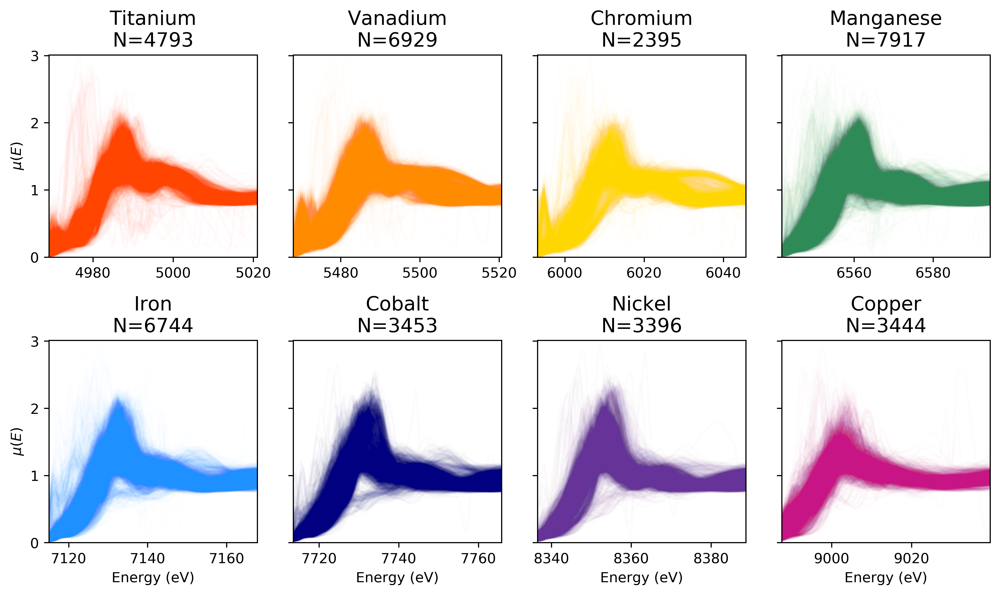

In [13]:
from mpl_toolkits.axes_grid.inset_locator import inset_axes
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
import matplotlib.colors as colors
import matplotlib.cm as cm

colors_by_pair = {('Ti','O'):'orangered',
                  ('V','O'):'darkorange',
                  ('Cr','O'):'gold',
                  ('Mn','O'):'seagreen',
                  ('Fe','O'):'dodgerblue',
                  ('Co','O'):'navy',
                  ('Ni','O'):'rebeccapurple',
                  ('Cu','O'):"mediumvioletred"}

coord_alph_by_pair = {
                   ('Co','O'): {4:.1,5:.1,6:.1},
                   ('Fe','O'): {4:.1,5:.1,6:.1},
                   ('V','O'):  {4:.1,5:.1,6:.1},
                   ('Cu','O'): {4:.1,5:.1,6:.1},
                   ('Ni','O'): {4:.1,5:.1,6:.1},
                   ('Cr','O'): {4:.1,5:.1,6:.1},
                   ('Mn','O'): {4:.1,5:.1,6:.1},
                   ('Ti','O'): {4:.1,5:.1,6:.1}}

outlier_prune={ ('Co','O'): 3,
               ('Fe','O'): 4,
               ('V','O'): 3.1,
               ('Cu','O'): 5,
               ('Ni','O'): 3.1,
               ('Cr','O'): 5, 
               ('Mn','O'): 4.5,
               ('Ti','O'): 4}

lc_by_pair = {pair:[] for pair in target_elements_groups}

global_max_height = -1000
global_min_height = 1000

for i, pairdat in enumerate(data_by_pair.items()):
    data = pairdat[1]
    filtered_by_both =[dat for dat in data if dat['bader'] or (dat['coordination'] in [4,5,6])]
    
    global_max_height = max(global_max_height, np.max(dat['mu']))
    global_min_height = min(global_min_height, np.min(dat['mu']))
    
both_fig = plt.figure(figsize=(10,6),constrained_layout = False,dpi=450)

gs = both_fig.add_gridspec(2,4)

norm = colors.Normalize(vmin=global_min_height, vmax=3)

ax1 = both_fig.add_subplot(gs[0,0])
ax2 = both_fig.add_subplot(gs[0,1])
ax3 = both_fig.add_subplot(gs[0,2])
ax4 = both_fig.add_subplot(gs[0,3])
ax5 = both_fig.add_subplot(gs[1,0])
ax6 = both_fig.add_subplot(gs[1,1])
ax7 = both_fig.add_subplot(gs[1,2])
ax8 = both_fig.add_subplot(gs[1,3])

all_axes = [ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8]

for i, pairdat in enumerate(data_by_pair.items()):
    pair = pairdat[0]
    data = pairdat[1]
    ax = all_axes[i]


    filtered_by_both =[dat for dat in data if dat['bader'] or dat['coordination'] in [4,5,6] or dat.get('one_hot_coord')]
    
    
    n_all_spectra = len(filtered_by_both)
    cur_spectra = [XAS_Spectrum(dat['E'],dat['mu']) for dat in filtered_by_both]
    n_pruned = n_all_spectra- len(cur_spectra)
    print(pair,'pruned:',n_pruned)
    
    
    spectra_maxes = [np.max(spec.y) for spec in cur_spectra]
    
    spectra_sorted = sorted([(themax,spec) for themax,spec in zip(spectra_maxes,cur_spectra)], key = lambda x: x[0])
    
    cur_spectra = [spec[1] for spec in spectra_sorted]
    #print(pair,len(filtered_by_bader))
    
    min_x = np.min([np.min(spec.x) for spec in cur_spectra])
    max_x = np.max([np.max(spec.x) for spec in cur_spectra])
    
    #min_bader = np.min(baders)
    #max_bader = np.max(baders)

    
    lines = [np.column_stack([spec.x,spec.y]) for spec in cur_spectra]
    color_array = [spec_map(norm(np.max(spec.y))) for spec in cur_spectra]

    #lc = LineCollection(lines,colors=color_array,
    lc = LineCollection(lines,colors=[colors_by_pair[pair]]*len(lines),
                       alpha = 1/sqrt(2*len(lines)))
    ax.add_collection(lc)
    
    #ax.ylabel("$\mu (E)$")
    #ax.set_ylim(-.01,1.02)
    ax.set_ylim(0,3.01)
    ax.set_xlim(min_x,max_x)


    #plt.hist(baders,color='black',bins=15)
    ax.set_title("{}\nN={}".format(pair_to_label[pair[0]],len(cur_spectra)),color='black',
                size=14),
    if pair[0] in['Ti','Fe']:
        ax.set_ylabel('$\mu(E)$')
        y_labels = np.arange(0,4,1)
        ax.set_yticks(y_labels)
    else:
        ax.set_yticklabels([])
        ax.set_yticks(y_labels)

        
    if pair[0] in ['Fe','Co','Ni','Cu']:
        ax.set_xlabel("Energy (eV)")
    #ax.set_xticks([])
    
#bader_fig.subplots_adjust(right=0.9)
#cbar_ax = bader_fig.add_axes([0.95, 0.15, 0.05, 0.7])
#cbar_ax = bader_fig.add_axes([1.0, 0.15, 0.05, 0.7])

#bader_fig.colorbar(cm.ScalarMappable(norm=norm, cmap=spec_map), cax=cbar_ax,shrink=.8)
plt.tight_layout()
#plt.savefig("../RF/gen_figures/bader_spectra.pdf",format='pdf',dpi=300,bbox_inches='tight',transparent=True)
plt.savefig("../RF/gen_figures/both_spectra.png",format='png',dpi=300,bbox_inches='tight')

plt.show()

# Oxidation State

Counter({4.0: 2399, 3.0: 239, -2.0: 75, 2.0: 41, -1.0: 1})
non integral values: 287 /3042


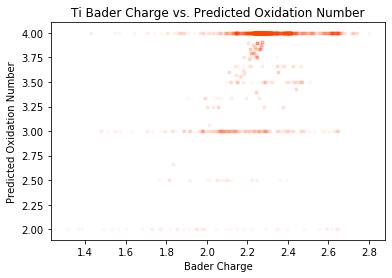

Counter({5.0: 1239, 3.0: 872, 4.0: 713, 2.0: 285, -2.0: 130, 1.0: 1})
non integral values: 559 /3799


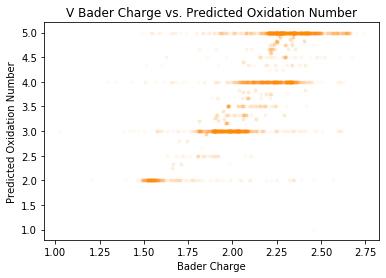

Counter({3.0: 611,
         6.0: 271,
         2.0: 247,
         4.0: 224,
         5.0: 133,
         -2.0: 61,
         1.0: 9,
         -1.0: 2})
non integral values: 247 /1805


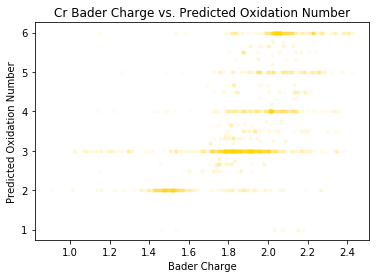

Counter({2.0: 1588,
         3.0: 826,
         4.0: 402,
         7.0: 204,
         -2.0: 112,
         5.0: 40,
         1.0: 4,
         6.0: 2,
         -1.0: 1})
non integral values: 772 /3951


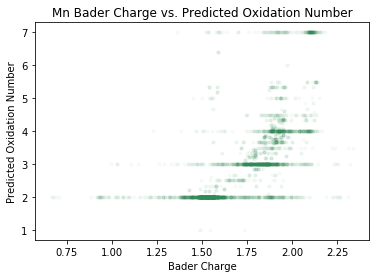

Counter({3.0: 1792, 2.0: 751, -2.0: 80, 1.0: 10, 4.0: 7, 5.0: 5, -3.0: 1})
non integral values: 381 /3027


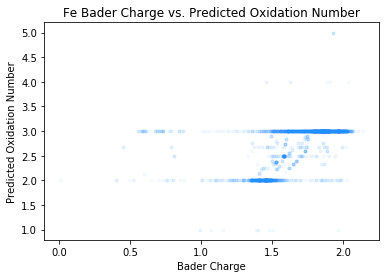

Counter({2.0: 715, 3.0: 342, 4.0: 282, -2.0: 141, 1.0: 31, -1.0: 4, 5.0: 3})
non integral values: 514 /2032


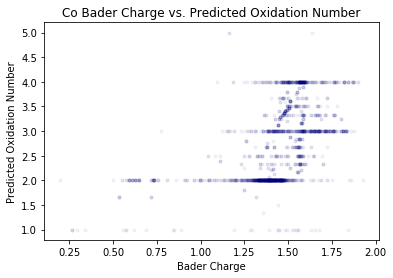

Counter({2.0: 1070, 3.0: 292, 4.0: 196, -2.0: 90, 1.0: 22, 5.0: 4, -1.0: 1})
non integral values: 503 /2178


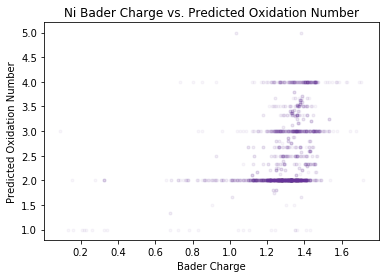

Counter({2.0: 1015, 1.0: 492, 3.0: 219, -2.0: 54, 4.0: 5})
non integral values: 266 /2051


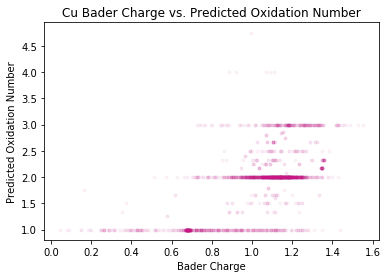

In [14]:
from collections import Counter
from scipy.stats import linregress

baders_by_pair = {pair:[] for pair in target_elements_groups}

for i, pairdat in enumerate(data_by_pair.items()):
    pair = pairdat[0]
    data = pairdat[1]
    
    filtered_by_oxy =[dat for dat in data if dat.get('guessed_oxy') and dat.get('bader')]

    oxy_vals = [dat['guessed_oxy'] for dat in filtered_by_oxy]
    int_oxy_vals = [dat['guessed_oxy'] for dat in filtered_by_oxy if int(dat['guessed_oxy'])==dat['guessed_oxy']]

    pprint((Counter(int_oxy_vals)))
    non_integral_values = len([val for val in oxy_vals if int(val)!=val])
    print("non integral values: {} /{}".format(non_integral_values,len(oxy_vals)))
    print('==============================================')
    #plt.hist(oxy_vals,bins=50)
    #plt.title('{}'.format(pair))
    #plt.show()
    
    
    bader_and_oxy =[dat for dat in data if dat.get('guessed_oxy') and 
                    (isinstance(dat.get('bader'),float) and dat['bader']>0.) and
                   (isinstance(dat.get('guessed_oxy'),float) and dat['guessed_oxy']>0.)]
    baders = [dat['bader'] for dat in bader_and_oxy]
    oxys = [dat['guessed_oxy'] for dat in bader_and_oxy]
    
    
    m, b, r, p, std_err  = linregress(baders,oxys)    
    plt.scatter(baders,oxys,alpha=2/np.sqrt(len(oxys)),color=colors_by_pair[pair],marker='.')
    
    #if 'Ti' not in pair or
    #X = np.linspace(min(baders),max(baders),100)
    #plt.plot(X, m*X +b, color='gray',ls='--',alpha=.6)
    plt.title('{} Bader Charge vs. Predicted Oxidation Number'.format(pair[0]))
    plt.xlabel("Bader Charge")
    plt.ylabel("Predicted Oxidation Number")
    plt.savefig('../RF/gen_figures/{}_bader_v_oxy.pdf'.format(pair[0]),
                format='pdf',dpi=300,transparent=True,bbox_inches='tight')
    plt.show()
    